[Reference: DCGAN + GENERATE FACES](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html?highlight=gan)

In [32]:
from __future__ import print_function
import torch
import torch.nn as nn
import torchvision.utils as utils
from torchvision.utils import save_image
import torch.nn.parallel 
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


In [5]:
manualSeed = 999
torch.manual_seed(manualSeed)

In [6]:
dataroot = "/celeba-dataset/"
workers = 2
batch_size = 64
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 5
lr = 0.0002
beta1 = 0.5

In [8]:
dataset = dset.ImageFolder(root = dataroot,
                          transform = transforms.Compose(
                          [transforms.Resize(image_size),
                           transforms.CenterCrop(image_size),
                           transforms.ToTensor(),
                           transforms.Normalize((0.5, 0.5, 0.5),(0.5, 0.5, 0.5))
                          ]))
dataloader = torch.utils.data.DataLoader(dataset, batch_size = batch_size,
                                         shuffle= True, num_workers= workers)
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

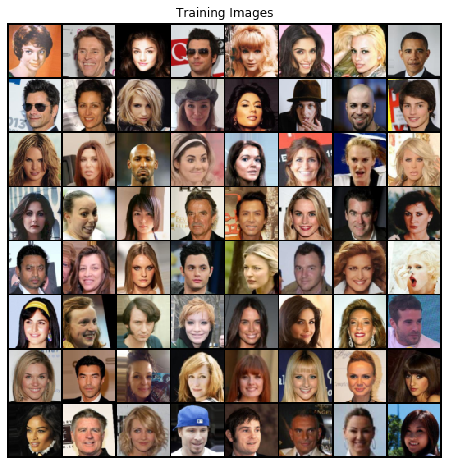

In [10]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(utils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [11]:
# Weight Initialization 
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [13]:
# Generator
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64          
        )
        
    def forward(self, inputs):
        return self.main(inputs)

In [14]:
generator = Generator()
generator.apply(weights_init)
print(generator)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [15]:
# Discriminator
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
        
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf*2, ndf *4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True),
            
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, inputs):
        return self.main(inputs)

In [16]:
discriminator = Discriminator()
discriminator.apply(weights_init)
print(discriminator)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [17]:
Criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1)
real_label = 1
fake_label = 0
optimizer_D = optim.Adam(discriminator.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, 0.999))


In [20]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop.....")
for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        
        discriminator.zero_grad()
        real = data[0]
        b_size = real.size(0)
        label = torch.full((b_size,), real_label)
        output = discriminator(real).view(-1)
        error_d_real = Criterion(output, label)
        
        error_d_real.backward()
        D_x = output.mean().item()
        
        
        noise = torch.randn(b_size, nz, 1, 1)
        fake = generator(noise)
        label.fill_(fake_label)
        output = discriminator(fake.detach()).view(-1)
        error_d_fake = Criterion(output, label)
        error_d_fake.backward()
        d_g_z1 = output.mean().item()
        err_d = error_d_fake + error_d_real
        optimizer_D.step()
        
        generator.zero_grad()
        label.fill_(real_label)
        output = discriminator(fake).view(-1)
        error_g = Criterion(output, label)
        error_g.backward()
        d_g_z2 = output.mean().item()
        optimizer_G.step()
        
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     err_d.item(), error_g.item(), D_x, d_g_z1, d_g_z2))

        # Save Losses for plotting later
        G_losses.append(error_g.item())
        D_losses.append(err_d.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(utils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop.....
[0/5][0/3166]	Loss_D: 1.0209	Loss_G: 6.3912	D(x): 0.9475	D(G(z)): 0.5543 / 0.0027
[0/5][50/3166]	Loss_D: 0.1433	Loss_G: 24.0613	D(x): 0.9059	D(G(z)): 0.0000 / 0.0000
[0/5][100/3166]	Loss_D: 0.7484	Loss_G: 13.7534	D(x): 0.9686	D(G(z)): 0.4338 / 0.0000
[0/5][150/3166]	Loss_D: 0.3554	Loss_G: 4.0924	D(x): 0.8597	D(G(z)): 0.1313 / 0.0315
[0/5][200/3166]	Loss_D: 0.4532	Loss_G: 4.1385	D(x): 0.7707	D(G(z)): 0.0430 / 0.0257
[0/5][250/3166]	Loss_D: 2.3998	Loss_G: 4.0158	D(x): 0.2389	D(G(z)): 0.0034 / 0.0461
[0/5][300/3166]	Loss_D: 0.7523	Loss_G: 7.4294	D(x): 0.5824	D(G(z)): 0.0026 / 0.0015
[0/5][350/3166]	Loss_D: 0.6879	Loss_G: 3.8939	D(x): 0.9261	D(G(z)): 0.3743 / 0.0599
[0/5][400/3166]	Loss_D: 0.8441	Loss_G: 4.9909	D(x): 0.8594	D(G(z)): 0.3877 / 0.0233
[0/5][450/3166]	Loss_D: 0.5056	Loss_G: 5.1846	D(x): 0.8656	D(G(z)): 0.2520 / 0.0098
[0/5][500/3166]	Loss_D: 0.3187	Loss_G: 4.2248	D(x): 0.8987	D(G(z)): 0.1632 / 0.0242
[0/5][550/3166]	Loss_D: 0.8588	Loss_G: 9.1239	D(x

[1/5][1650/3166]	Loss_D: 1.0114	Loss_G: 0.6869	D(x): 0.5489	D(G(z)): 0.1968 / 0.5466
[1/5][1700/3166]	Loss_D: 1.1545	Loss_G: 5.2528	D(x): 0.9473	D(G(z)): 0.5901 / 0.0087
[1/5][1750/3166]	Loss_D: 0.6465	Loss_G: 2.4611	D(x): 0.6109	D(G(z)): 0.0389 / 0.1240
[1/5][1800/3166]	Loss_D: 0.5087	Loss_G: 2.6903	D(x): 0.7308	D(G(z)): 0.1375 / 0.0993
[1/5][1850/3166]	Loss_D: 0.4729	Loss_G: 2.6751	D(x): 0.7431	D(G(z)): 0.1271 / 0.1032
[1/5][1900/3166]	Loss_D: 0.6451	Loss_G: 2.9842	D(x): 0.7920	D(G(z)): 0.2843 / 0.0678
[1/5][1950/3166]	Loss_D: 0.3968	Loss_G: 2.0568	D(x): 0.7600	D(G(z)): 0.0811 / 0.1641
[1/5][2000/3166]	Loss_D: 1.1687	Loss_G: 1.0279	D(x): 0.3846	D(G(z)): 0.0370 / 0.4227
[1/5][2050/3166]	Loss_D: 0.6784	Loss_G: 4.4617	D(x): 0.9058	D(G(z)): 0.3927 / 0.0174
[1/5][2100/3166]	Loss_D: 1.2318	Loss_G: 4.9284	D(x): 0.9727	D(G(z)): 0.6384 / 0.0111
[1/5][2150/3166]	Loss_D: 0.4221	Loss_G: 3.3077	D(x): 0.8339	D(G(z)): 0.1931 / 0.0552
[1/5][2200/3166]	Loss_D: 1.6975	Loss_G: 1.9306	D(x): 0.2543	D(G(z

[3/5][100/3166]	Loss_D: 0.5835	Loss_G: 2.9101	D(x): 0.8008	D(G(z)): 0.2526 / 0.0690
[3/5][150/3166]	Loss_D: 0.3999	Loss_G: 2.3401	D(x): 0.8193	D(G(z)): 0.1571 / 0.1146
[3/5][200/3166]	Loss_D: 0.2984	Loss_G: 3.7114	D(x): 0.9275	D(G(z)): 0.1812 / 0.0345
[3/5][250/3166]	Loss_D: 0.4833	Loss_G: 4.6016	D(x): 0.9340	D(G(z)): 0.3031 / 0.0145
[3/5][300/3166]	Loss_D: 0.3951	Loss_G: 2.6666	D(x): 0.8464	D(G(z)): 0.1809 / 0.0885
[3/5][350/3166]	Loss_D: 0.3253	Loss_G: 2.9214	D(x): 0.8807	D(G(z)): 0.1572 / 0.0675
[3/5][400/3166]	Loss_D: 0.7100	Loss_G: 3.1842	D(x): 0.8805	D(G(z)): 0.3843 / 0.0568
[3/5][450/3166]	Loss_D: 0.7374	Loss_G: 4.2338	D(x): 0.8857	D(G(z)): 0.4145 / 0.0234
[3/5][500/3166]	Loss_D: 0.5560	Loss_G: 4.5884	D(x): 0.9329	D(G(z)): 0.3392 / 0.0151
[3/5][550/3166]	Loss_D: 0.4587	Loss_G: 2.0960	D(x): 0.7812	D(G(z)): 0.1377 / 0.1604
[3/5][600/3166]	Loss_D: 1.1336	Loss_G: 1.0779	D(x): 0.4026	D(G(z)): 0.0484 / 0.4070
[3/5][650/3166]	Loss_D: 0.5228	Loss_G: 3.2188	D(x): 0.8545	D(G(z)): 0.2528 /

[4/5][1750/3166]	Loss_D: 0.4634	Loss_G: 1.9224	D(x): 0.7049	D(G(z)): 0.0503 / 0.1994
[4/5][1800/3166]	Loss_D: 0.7961	Loss_G: 5.9139	D(x): 0.9622	D(G(z)): 0.4665 / 0.0043
[4/5][1850/3166]	Loss_D: 0.2848	Loss_G: 3.9693	D(x): 0.9035	D(G(z)): 0.1484 / 0.0249
[4/5][1900/3166]	Loss_D: 1.4412	Loss_G: 0.5610	D(x): 0.3947	D(G(z)): 0.1814 / 0.6141
[4/5][1950/3166]	Loss_D: 0.5437	Loss_G: 2.2137	D(x): 0.7374	D(G(z)): 0.1361 / 0.1544
[4/5][2000/3166]	Loss_D: 0.8925	Loss_G: 4.8981	D(x): 0.9622	D(G(z)): 0.5020 / 0.0114
[4/5][2050/3166]	Loss_D: 0.3029	Loss_G: 3.3078	D(x): 0.9171	D(G(z)): 0.1803 / 0.0439
[4/5][2100/3166]	Loss_D: 3.5886	Loss_G: 5.9570	D(x): 0.9940	D(G(z)): 0.9426 / 0.0050
[4/5][2150/3166]	Loss_D: 0.6468	Loss_G: 4.4446	D(x): 0.8676	D(G(z)): 0.3147 / 0.0167
[4/5][2200/3166]	Loss_D: 0.4728	Loss_G: 2.4909	D(x): 0.6923	D(G(z)): 0.0473 / 0.1273
[4/5][2250/3166]	Loss_D: 0.3434	Loss_G: 3.2384	D(x): 0.8978	D(G(z)): 0.1873 / 0.0514
[4/5][2300/3166]	Loss_D: 0.7970	Loss_G: 4.3926	D(x): 0.8998	D(G(z

In [21]:
torch.save(generator.state_dict(), 'generator_dcgan.pt')
torch.save(discriminator.state_dict(), 'discriminator_dcgan.pt')

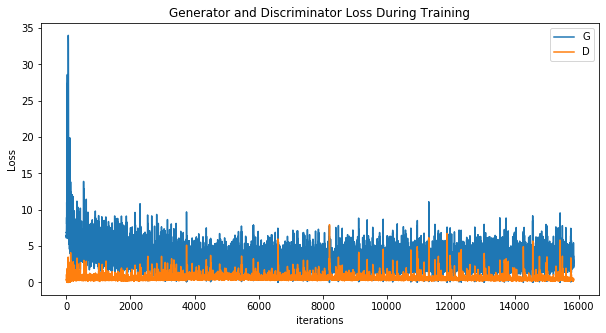

In [22]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

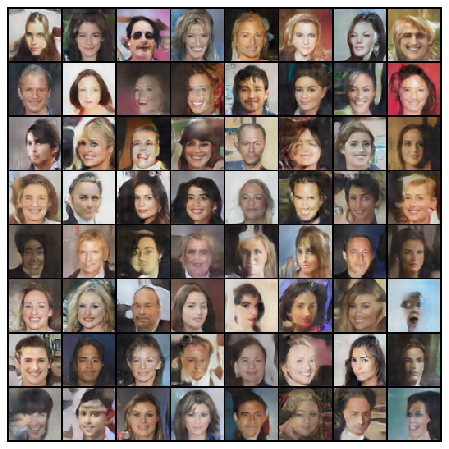

In [23]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [34]:
save_image(img_list[1],"img_2.png")

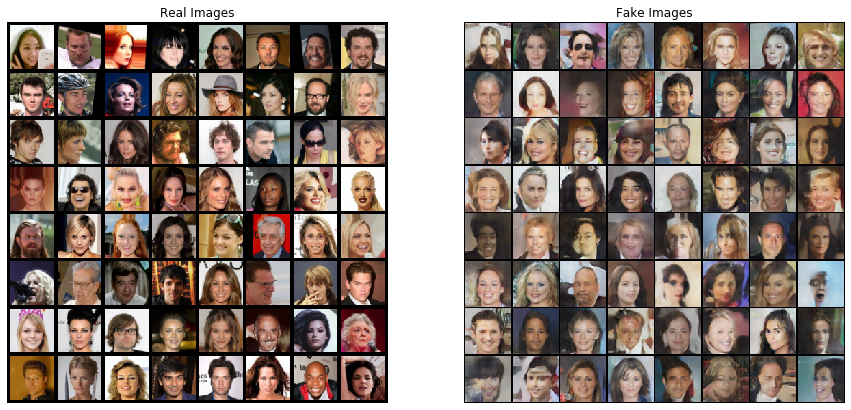

In [26]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()